# **Exploratory Data Analysis & Forecasting of Dengue Cases In Sri Lanka**

## **Import & Install Required Dependencies**

In [8]:
pip install keplergl

In [9]:
pip install geopandas

In [10]:
#import dependencies
from fbprophet import Prophet
from fbprophet.diagnostics import cross_validation , performance_metrics
from fbprophet.plot import add_changepoints_to_plot
from statsmodels.tsa.stattools import adfuller
import pandas as pd
import geopandas as gpd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
from keplergl import KeplerGl
import warnings
warnings.filterwarnings("ignore")

## **Exploratory Data Analysis & Visualization**

In [11]:
#import dataset
df = pd.read_excel('/content/drive/MyDrive/Colab Materials/Dengue Patients/Dengue_Data (2010-2021).xlsx')

#replace city names 
df.replace(to_replace ="Kalminai", value ="Ampara",inplace=True)

#display first 5 rows of the dataset
df.head(10)

,Date,City,Value
0,2010-01-01,Colombo,584
1,2010-02-01,Colombo,606
2,2010-03-01,Colombo,294
3,2010-04-01,Colombo,224
4,2010-05-01,Colombo,296
5,2010-06-01,Colombo,700
6,2010-07-01,Colombo,1530
7,2010-08-01,Colombo,881
8,2010-09-01,Colombo,312
9,2010-10-01,Colombo,267


In [12]:
#display last 5 rows of the dataset
df.tail(10)

,Date,City,Value
3734,2021-03-01,Ampara,57
3735,2021-04-01,Ampara,77
3736,2021-05-01,Ampara,39
3737,2021-06-01,Ampara,20
3738,2021-07-01,Ampara,7
3739,2021-08-01,Ampara,3
3740,2021-09-01,Ampara,0
3741,2021-10-01,Ampara,0
3742,2021-11-01,Ampara,0
3743,2021-12-01,Ampara,0


### **Pre Processing & Data Cleaning**

In [13]:
#remove non data rows becasue its a time series, data of last months of 2021 still not be recoreded
df = df[~(df['Date'] > '2020-12-01')]

#check dataset after drop non data rows
df.tail(10)

,Date,City,Value
3422,2020-03-01,Ampara,39
3423,2020-04-01,Ampara,30
3424,2020-05-01,Ampara,11
3425,2020-06-01,Ampara,17
3426,2020-07-01,Ampara,13
3427,2020-08-01,Ampara,21
3428,2020-09-01,Ampara,40
3429,2020-10-01,Ampara,30
3430,2020-11-01,Ampara,9
3431,2020-12-01,Ampara,12


In [14]:
#Year Wise Dengue Patients Distribution
dcw = pd.DataFrame(df.groupby(['City']).agg({'Value':'sum'}).reset_index())
dcw

,City,Value
0,Ampara,14191
1,Anuradapura,9632
2,Badulla,12612
3,Battocolo,24286
4,Colombo,147726
5,Galle,26075
6,Gampaha,97038
7,Hambantota,11104
8,Jaffna,31990
9,Kalutara,39960


In [15]:
# define function to plot customized line charts

def line_chart(data_li ,x_vr, y_vr, colour_li, titl, x_n, y_n ):
  #defune figure
  fig = go.Figure()

  #define line chart
  fig.add_trace(go.Scatter(
      x= data_li[x_vr], y = data_li[y_vr],
      mode = 'lines',
      line=dict(width=3, color=colour_li)))
  
  #add title details
  fig.update_layout(
      title = titl,
      title_font_size = 25, legend_font_size = 10,
      width = 1300, height = 520,template='plotly_dark')
  
  #add X axis details
  fig.update_xaxes(
      title_text = x_n ,
      title_font=dict(size=15, family='Verdana', color='white'),
      tickfont=dict(family='Calibri', color='white', size=15))
  
  #add Y axis details
  fig.update_yaxes(
      title_text = y_n,
      title_font=dict(size=15, family='Verdana', color='white'),
      tickfont=dict(family='Calibri', color='white', size=15))

  #plot the line chart
  fig.show()

In [16]:
#define function to ploting customized bar graphs.

def customized_barchart(Data_frame, Attribute_name_Discrete, Attribute_name_Continious ,max_Colour_name, Rest_colour_name ,Title_name, Yaxis_name, Xaxis_name, Template_name):

  #set axis colours according to theme colour
  if Template_name == 'plotly_dark':

       COL_TICKS = 'white'

  else:
       COL_TICKS = 'black'

  #set max colour effect to maximum value
  list_series = [i for i in Data_frame[Attribute_name_Continious]]
  length = len(list_series)

  colors = [Rest_colour_name,] * length
  colors[list_series.index(max(list_series))] = max_Colour_name

  #setting ploting figure & main propertise 
  fig = go.Figure(data=[go.Bar( x =Data_frame[Attribute_name_Discrete], y= Data_frame[Attribute_name_Continious], marker_color=colors )])

  #add layout styles
  fig.update_layout(title_text=Title_name,
                    title_font_size = 25, legend_font_size = 10,
                    width=1300, height=520,
                    template=Template_name)
  
  #add xaxxes styles
  fig.update_xaxes(title_text = Xaxis_name,
                    title_font=dict(size=15, family='Verdana', color=COL_TICKS),
                    tickfont=dict(family='Calibri', color=COL_TICKS, size=15))
                    
  #add yaxes styles
  fig.update_yaxes(title_text = Yaxis_name,
                    title_font=dict(size=15, family='Verdana', color=COL_TICKS),
                    tickfont=dict(family='Calibri', color=COL_TICKS, size=15))

                    
  fig.show()

In [17]:
#derive yearly & monthly wise data with correct order
dpt = pd.DataFrame(df.groupby(['Date']).agg({'Value':'sum'}).reset_index())
dpt

,Date,Value
0,2010-01-01,4805
1,2010-02-01,4731
2,2010-03-01,2528
3,2010-04-01,2004
4,2010-05-01,1950
...,...,...
127,2020-08-01,1559
128,2020-09-01,1214
129,2020-10-01,1030
130,2020-11-01,781


In [18]:
#function to derive year
def derive_year(data_y):
  #split date 
  data_list_y = str(data_y).split('-')

  #slice year from the splited data
  return data_list_y[0]

#function to derive month
def derive_month(data_m):
  #split date 
  data_list_m = str(data_m).split('-')

  #slice year from the splited data
  return data_list_m[1]


dymd = dpt
dymd['year'] = dymd['Date'].apply(lambda x : derive_year(x))
dymd['month'] = dymd['Date'].apply(lambda x : derive_month(x))

dymd

,Date,Value,year,month
0,2010-01-01,4805,2010,01
1,2010-02-01,4731,2010,02
2,2010-03-01,2528,2010,03
3,2010-04-01,2004,2010,04
4,2010-05-01,1950,2010,05
...,...,...,...,...
127,2020-08-01,1559,2020,08
128,2020-09-01,1214,2020,09
129,2020-10-01,1030,2020,10
130,2020-11-01,781,2020,11


In [19]:
#Year Wise Dengue Patients Distribution
dpyds = pd.DataFrame(dymd.groupby(['year']).agg({'Value':'sum'}).reset_index())
dpyds

,year,Value
0,2010,34188
1,2011,28473
2,2012,44461
3,2013,32063
4,2014,47502
5,2015,29777
6,2016,55150
7,2017,186101
8,2018,51659
9,2019,105049


In [20]:
#Year Wise Dengue Patients Distribution (by summation)
dpmds = pd.DataFrame(dymd.groupby(['month']).agg({'Value':'sum'}).reset_index())
dpmds

,month,Value
0,01,65228
1,02,44685
2,03,38011
3,04,32328
4,05,42724
5,06,67337
6,07,96369
7,08,62992
8,09,36534
9,10,37751


In [21]:
#Year Wise Dengue Patients Distribution (by average)
dpmdsa = pd.DataFrame(dymd.groupby(['month']).agg({'Value':'mean'}).reset_index())
dpmdsa

,month,Value
0,01,5929.818182
1,02,4062.272727
2,03,3455.545455
3,04,2938.909091
4,05,3884.000000
5,06,6121.545455
6,07,8760.818182
7,08,5726.545455
8,09,3321.272727
9,10,3431.909091


In [22]:
#read shape file
regions = gpd.read_file("/content/drive/MyDrive/Colab Materials/Geospatial Sri Lanka Boundaries/lka_admbnda_adm2_slsd_20200305.shp")

#skip unwanted rows from the dataframe
regions = regions.iloc[1:,:]

#display first 5 rows
regions.head()


,ADM2_EN,ADM2_SI,ADM2_TA,ADM2_PCODE,ADM2_REF,ADM2ALT1EN,ADM2ALT2EN,ADM2ALT1SI,ADM2ALT2SI,ADM2ALT1TA,ADM2ALT2TA,ADM1_EN,ADM1_SI,ADM1_TA,ADM1_PCODE,ADM0_EN,ADM0_SI,ADM0_TA,ADM0_PCODE,Shape_Leng,Shape_Area,date,validOn,validTo,geometry
1,Ampara,අම්පාර දිස්ත්‍රික,அம்பாறை மாவட்டம்,LK52,None,None,None,None,None,None,None,Eastern,නැගෙනහිර පළාත,கிழக்கு மாகாணம்,LK5,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,5.397133,0.366562,2019-03-04,2020-03-05,None,"POLYGON ((81.23892 7.73850, 81.23903 7.73846, ..."
2,Anuradhapura,අනුරාධපුර දිස්ත්‍,அனுராதபுரம் மாவட்,LK71,None,None,None,None,None,None,None,North Central,උතුරු මැද පළාත,வட மத்திய மாகாணம்,LK7,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,4.539544,0.592676,2019-03-04,2020-03-05,None,"POLYGON ((80.79126 8.91877, 80.79164 8.91876, ..."
3,Badulla,බදුල්ල දිස්ත්‍රික,பதுளை மாவட்டம்,LK81,None,None,None,None,None,None,None,Uva,ඌව පළාත,ஊவா மாகாணம்,LK8,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,3.940419,0.235108,2019-03-04,2020-03-05,None,"POLYGON ((80.98060 7.61768, 80.98104 7.61765, ..."
4,Batticaloa,මඩකලපුව දිස්ත්‍රි,மட்டக்களப்பு மாவட,LK51,None,None,None,None,None,None,None,Eastern,නැගෙනහිර පළාත,கிழக்கு மாகாணம்,LK5,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,6.468261,0.203262,2019-03-04,2020-03-05,None,"MULTIPOLYGON (((81.76936 7.53607, 81.76918 7.5..."
5,Colombo,කොළඹ දිස්ත්‍රික්ක,கொழும்பு மாவட்டம்,LK11,None,None,None,None,None,None,None,Western,බස්නාහිර පළාත,மேல் மாகாணம்,LK1,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,1.887285,0.056092,2019-03-04,2020-03-05,None,"POLYGON ((79.87696 6.98085, 79.87805 6.98068, ..."


In [23]:
#checking data types
regions.dtypes

ADM2_EN         object
ADM2_SI         object
ADM2_TA         object
ADM2_PCODE      object
ADM2_REF        object
ADM2ALT1EN      object
ADM2ALT2EN      object
ADM2ALT1SI      object
ADM2ALT2SI      object
ADM2ALT1TA      object
ADM2ALT2TA      object
ADM1_EN         object
ADM1_SI         object
ADM1_TA         object
ADM1_PCODE      object
ADM0_EN         object
ADM0_SI         object
ADM0_TA         object
ADM0_PCODE      object
Shape_Leng     float64
Shape_Area     float64
date            object
validOn         object
validTo         object
geometry      geometry
dtype: object

In [24]:
#cheking for null 
regions.isnull().sum()

ADM2_EN        0
ADM2_SI        0
ADM2_TA        0
ADM2_PCODE     0
ADM2_REF      25
ADM2ALT1EN    25
ADM2ALT2EN    25
ADM2ALT1SI    25
ADM2ALT2SI    25
ADM2ALT1TA    25
ADM2ALT2TA    25
ADM1_EN        0
ADM1_SI        0
ADM1_TA        0
ADM1_PCODE     0
ADM0_EN        0
ADM0_SI        0
ADM0_TA        0
ADM0_PCODE     0
Shape_Leng     0
Shape_Area     0
date           0
validOn        0
validTo       25
geometry       0
dtype: int64

In [25]:
print('Districts In Dengue Cases Dataset')

print(dcw['City'].unique())

print('  ')

print('Districts In Spatial File')
print(regions['ADM2_EN'].unique())

Districts In Dengue Cases Dataset
['Ampara' 'Anuradapura' 'Badulla' 'Battocolo' 'Colombo' 'Galle' 'Gampaha'
 'Hambantota' 'Jaffna' 'Kalutara' 'Kandy' 'Kegalla' 'Killinochchi'
 'Kurunegala' 'Mannar' 'Matale' 'Matara' 'Monaragala' 'Mulative' 'N eliya'
 'Polonnaruwa' 'Puttalama' 'Rathnapura' 'Trincomalee' 'Vauniya']
  
Districts In Spatial File
['Ampara' 'Anuradhapura' 'Badulla' 'Batticaloa' 'Colombo' 'Galle'
 'Gampaha' 'Hambantota' 'Jaffna' 'Kalutara' 'Kandy' 'Kegalle'
 'Kilinochchi' 'Kurunegala' 'Mannar' 'Matale' 'Matara' 'Monaragala'
 'Mullaitivu' 'Nuwara Eliya' 'Polonnaruwa' 'Puttalam' 'Ratnapura'
 'Trincomalee' 'Vavuniya']


In [26]:
 #replace values to match each other
dcw.replace(to_replace ="Anuradapura", value ="Anuradhapura",inplace=True)
dcw.replace(to_replace ="Puttalama", value ="Puttalam",inplace=True)
dcw.replace(to_replace ="Battocolo", value ="Batticaloa",inplace=True)
dcw.replace(to_replace ="Kegalla", value ="Kegalle",inplace=True)
dcw.replace(to_replace ="Killinochchi", value ="Kilinochchi",inplace=True)
dcw.replace(to_replace ="Rathnapura", value ="Ratnapura",inplace=True)
dcw.replace(to_replace ="N eliya", value ="Nuwara Eliya",inplace=True)
dcw.replace(to_replace ="Vauniya", value ="Vavuniya",inplace=True)
dcw.replace(to_replace ="Mulative", value ="Mullaitivu",inplace=True)

In [27]:
#Joining Dataframes for gain Insights
regions.rename(columns={'ADM2_EN':'City'}, inplace=True)
dcw_joined = pd.merge(regions, dcw, on=['City'],how='left')
dcw_joined

,City,ADM2_SI,ADM2_TA,ADM2_PCODE,ADM2_REF,ADM2ALT1EN,ADM2ALT2EN,ADM2ALT1SI,ADM2ALT2SI,ADM2ALT1TA,ADM2ALT2TA,ADM1_EN,ADM1_SI,ADM1_TA,ADM1_PCODE,ADM0_EN,ADM0_SI,ADM0_TA,ADM0_PCODE,Shape_Leng,Shape_Area,date,validOn,validTo,geometry,Value
0,Ampara,අම්පාර දිස්ත්‍රික,அம்பாறை மாவட்டம்,LK52,None,None,None,None,None,None,None,Eastern,නැගෙනහිර පළාත,கிழக்கு மாகாணம்,LK5,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,5.397133,0.366562,2019-03-04,2020-03-05,None,"POLYGON ((81.23892 7.73850, 81.23903 7.73846, ...",14191
1,Anuradhapura,අනුරාධපුර දිස්ත්‍,அனுராதபுரம் மாவட்,LK71,None,None,None,None,None,None,None,North Central,උතුරු මැද පළාත,வட மத்திய மாகாணம்,LK7,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,4.539544,0.592676,2019-03-04,2020-03-05,None,"POLYGON ((80.79126 8.91877, 80.79164 8.91876, ...",9632
2,Badulla,බදුල්ල දිස්ත්‍රික,பதுளை மாவட்டம்,LK81,None,None,None,None,None,None,None,Uva,ඌව පළාත,ஊவா மாகாணம்,LK8,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,3.940419,0.235108,2019-03-04,2020-03-05,None,"POLYGON ((80.98060 7.61768, 80.98104 7.61765, ...",12612
3,Batticaloa,මඩකලපුව දිස්ත්‍රි,மட்டக்களப்பு மாவட,LK51,None,None,None,None,None,None,None,Eastern,නැගෙනහිර පළාත,கிழக்கு மாகாணம்,LK5,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,6.468261,0.203262,2019-03-04,2020-03-05,None,"MULTIPOLYGON (((81.76936 7.53607, 81.76918 7.5...",24286
4,Colombo,කොළඹ දිස්ත්‍රික්ක,கொழும்பு மாவட்டம்,LK11,None,None,None,None,None,None,None,Western,බස්නාහිර පළාත,மேல் மாகாணம்,LK1,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,1.887285,0.056092,2019-03-04,2020-03-05,None,"POLYGON ((79.87696 6.98085, 79.87805 6.98068, ...",147726
5,Galle,ගාල්ල දිස්ත්‍රික්,காலி மாவட்டம்,LK31,None,None,None,None,None,None,None,Southern,දකුණු පළාත,தென் மாகாணம்,LK3,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,2.589053,0.131859,2019-03-04,2020-03-05,None,"MULTIPOLYGON (((80.09646 6.13287, 80.09638 6.1...",26075
6,Gampaha,ගම්පහ දිස්ත්‍රික්,கம்பஹா மாவட்டம்,LK12,None,None,None,None,None,None,None,Western,බස්නාහිර පළාත,மேல் மாகாணம்,LK1,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,2.306268,0.113410,2019-03-04,2020-03-05,None,"POLYGON ((80.14677 7.31212, 80.14689 7.31182, ...",97038
7,Hambantota,හම්බන්තොට දිස්ත්‍,அம்பாந்தோட்டை மாவ,LK33,None,None,None,None,None,None,None,Southern,දකුණු පළාත,தென் மாகாணம்,LK3,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,3.707605,0.214369,2019-03-04,2020-03-05,None,"POLYGON ((81.61401 6.57217, 81.61425 6.57217, ...",11104
8,Jaffna,යාපනය දිස්ත්‍රික්,யாழ்ப்பாணம் மாவட்,LK41,None,None,None,None,None,None,None,Northern,උතුරු පළාත,வட மாகாணம்,LK4,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,5.914198,0.089918,2019-03-04,2020-03-05,None,"MULTIPOLYGON (((79.52615 9.38313, 79.52537 9.3...",31990
9,Kalutara,කඵතර දිස්ත්‍රික්ක,களுத்துறை மாவட்டம,LK13,None,None,None,None,None,None,None,Western,බස්නාහිර පළාත,மேல் மாகாணம்,LK1,Sri Lanka,ශ්‍රී ලංකා,இலங்கை,LK,2.041398,0.134691,2019-03-04,2020-03-05,None,"MULTIPOLYGON (((79.97717 6.44121, 79.97716 6.4...",39960


## **Exploratory Data Analysis & Visualization**

### **Dengue Cases Time series**

In [28]:
#call function to plot the chart

dataset_line_chart = dpt
x_line_chart = 'Date'
y_line_chart = 'Value'
colour_line_chart = 'red'
title_line_chart = 'Dengue Cases Time series'
xname_line_chart = 'Date'
yname_line_chart = 'Cases'

line_chart(dataset_line_chart, x_line_chart, y_line_chart, colour_line_chart, title_line_chart, xname_line_chart, yname_line_chart)

### **Year Wise Dengue Cases Distribution**

In [29]:
#deaths_percentage	cases_percentage

dfr = dpyds
attnd = 'year'
attnc = 'Value'

mcn = 'deepskyblue'
rcn = 'lightslategray'

tn = 'Year Wise Dengue Cases Distribution'
yxn = 'Cases'
xxn =  'Years'
tmpn = 'plotly_dark'

customized_barchart(dfr, attnd, attnc, mcn, rcn, tn, yxn, xxn, tmpn)

### **Monthly Wise Dengue Cases Distribution**

> #### *As Summation*

In [30]:
#deaths_percentage	cases_percentage

dfr = dpmds
attnd = 'month'
attnc = 'Value'

mcn = 'gold'
rcn = 'limegreen'

tn = 'Month Wise Total Dengue Cases Distribution'
yxn = 'Cases'
xxn =  'Month'
tmpn = 'plotly_dark'

customized_barchart(dfr, attnd, attnc, mcn, rcn, tn, yxn, xxn, tmpn)

> #### *As Average*

In [31]:
dfr = dpmdsa
attnd = 'month'
attnc = 'Value'

mcn = 'orange'
rcn = 'mediumaquamarine'

tn = 'Month Wise Average Dengue Cases Distribution'
yxn = 'Cases'
xxn =  'Month'
tmpn = 'plotly_dark'

customized_barchart(dfr, attnd, attnc, mcn, rcn, tn, yxn, xxn, tmpn)

In [32]:
#call function to plot the chart

dataset_line_chart = dpmdsa
x_line_chart = 'month'
y_line_chart = 'Value'
colour_line_chart = 'gold'
title_line_chart = 'Sessionaly Variance by Monthly Average of Dengue Cases'
xname_line_chart = 'Month'
yname_line_chart = 'Cases'

line_chart(dataset_line_chart, x_line_chart, y_line_chart, colour_line_chart, title_line_chart, xname_line_chart, yname_line_chart)

### **Dengue Cases Districts Wise Distribution**

In [33]:
#Dengue Patients City Wise Distribution

dfr = dcw
attnd = 'City'
attnc = 'Value'

mcn = 'crimson'
rcn = 'lightslategray'

tn = 'City Wise Total Dengue Cases Distribution'
yxn = 'Dengue Patients'
xxn =  'Districts'
tmpn = 'plotly_dark'

customized_barchart(dfr, attnd, attnc, mcn, rcn, tn, yxn, xxn, tmpn)

## **Geospatial Total Dengue Cases Visualization**

In [35]:
#access for widgets
from google.colab import output
output.enable_custom_widget_manager()

In [52]:
#create mat
map_1 = KeplerGl(height=600)
map_1.add_data(data=dcw_joined, name='SL_Dengue_Cases')
map_1

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'SL_Dengue_Cases': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18,…

### **Conclusions on Above Data Insights**



*   This time sereis stationery according to adfuller test, but it's  looks like non stationery becasue of 2017 dengue outbreak, therefore in **2017 july to june & 2019 november** shows more higher peaks in the time series, & also its not a sessionality variance

*  There is a seassionly variance. main reasion for that is **Northeast (december -january) & Southwest (may-september) monsoon  rain.**

* also after 2020 jan & feb the dengue patients counts has decreased. we can consider the covid 19 pandemic as the reasion for this. we consider two assumptions in here,

  
     1.   People are stay on home during the lockdown period therefore they have engough time to clean there enviroments & etc.
     2.   After covid 19 pandecmic people stay home & not admitted to the hospital even they are affected with dengue virus.


## **Forecasting Dengue Cases**

In [37]:
#pre proceesed dataset 
data = dpt[['Date','Value']]
data.columns = ['ds','y']
data

,ds,y
0,2010-01-01,4805
1,2010-02-01,4731
2,2010-03-01,2528
3,2010-04-01,2004
4,2010-05-01,1950
...,...,...
127,2020-08-01,1559
128,2020-09-01,1214
129,2020-10-01,1030
130,2020-11-01,781


In [38]:
#define function to check wheather time series is stationery or non staionery
def check_stationery(data_frame,values):

  result = adfuller(data_frame[str(values)])

  print(f'Test Statistics {result[0]}')
  print(' ')
  print(f'P value {result[1]}')
  print(' ')
  print(f'Critical Value {result[4]}')
  print(' ')
  print('------------------------------------------ ')
  print(' ')
  if result[1] > 0.05:
    print('Time Series is Not Stationery')

  else:
      print('Time Series is Stationery')


#call above defined function

#assign dataframe
dataset = data 

#assign neccesery column consists with values regarding to the dataframe
column_name = 'y'

check_stationery(dataset,column_name)

Test Statistics -3.595990307868561
 
P value 0.005838148775409035
 
Critical Value {'1%': -3.482087964046026, '5%': -2.8842185101614626, '10%': -2.578864381347275}
 
------------------------------------------ 
 
Time Series is Stationery


In [39]:
#check columns data type
data.dtypes

ds    datetime64[ns]
y              int64
dtype: object

In [40]:
#fit model
model = Prophet(yearly_seasonality=True, changepoint_prior_scale=0.7, changepoint_range=0.7)
model.fit(data)

INFO:numexpr.utils:NumExpr defaulting to 2 threads.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [41]:
#define future dates & preproccess
future = model.make_future_dataframe(periods=24,freq='m')

#function to derive year
def derive_year(data_y):
  #split date 
  data_list_y = str(data_y).split('-')

  #slice year from the splited data
  return data_list_y[0]

#function to derive month
def derive_month(data_m):
  #split date 
  data_list_m = str(data_m).split('-')

  #slice year from the splited data
  return data_list_m[1]


future['year'] = future['ds'].apply(lambda x : derive_year(x))
future['month'] = future['ds'].apply(lambda x : derive_month(x))
future['ds'] = future['year'] + '-' + future['month'] + '-' + '01'
future.drop(['year','month'],axis=1,inplace=True) 
future

,ds
0,2010-01-01
1,2010-02-01
2,2010-03-01
3,2010-04-01
4,2010-05-01
...,...
151,2022-07-01
152,2022-08-01
153,2022-09-01
154,2022-10-01


In [42]:
#change 'ds' column to datetime format
future['ds'] = pd.to_datetime(future['ds'], format='%Y-%m-%d')

#forecast the data
forecast = model.predict(future)

#display first 5 rows of the forecasted values
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].head()

,ds,yhat,yhat_lower,yhat_upper
0,2010-01-01,4133.292275,-1308.775468,9447.623687
1,2010-02-01,2262.199870,-2786.367707,7243.305258
2,2010-03-01,1207.689188,-3925.401704,6287.946854
3,2010-04-01,1009.778691,-4175.067786,6132.337360
4,2010-05-01,2137.480390,-2921.004876,7345.711899


In [43]:
#display last 5 rows of the forecasted values
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(10)

,ds,yhat,yhat_lower,yhat_upper
146,2022-02-01,-1304.512868,-6599.582699,3558.272471
147,2022-03-01,-2565.715842,-8024.504451,3145.882203
148,2022-04-01,-2992.464234,-8140.278359,2280.621770
149,2022-05-01,-2086.218561,-7525.158897,3584.373889
150,2022-06-01,-291.533701,-5175.864411,4896.280524
151,2022-07-01,1733.801186,-3954.417818,6851.933511
152,2022-08-01,-1335.984646,-6735.731439,4306.030124
153,2022-09-01,-3950.355687,-9451.721649,1136.556102
154,2022-10-01,-3895.762891,-9407.169957,1983.990759
155,2022-11-01,-2118.704461,-7416.373824,3525.260379


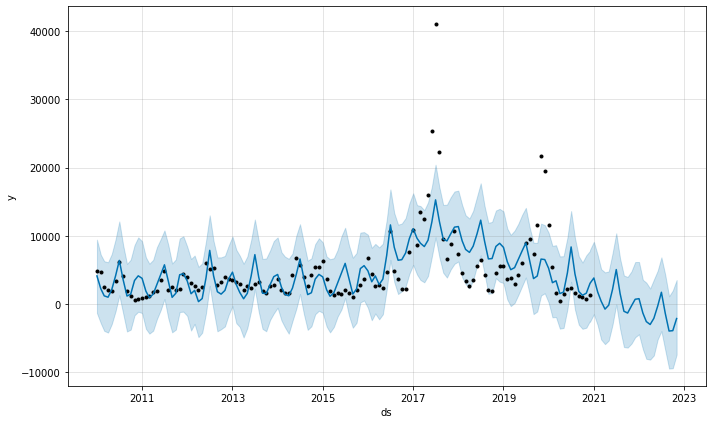

In [44]:
#forecasted values vs actual values
fig_1 = model.plot(forecast)

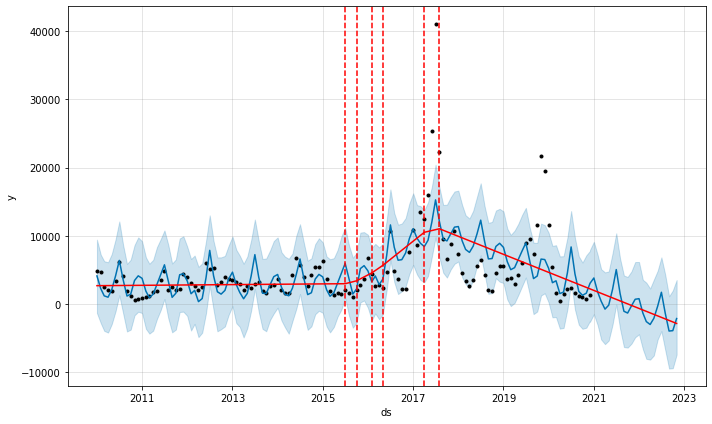

In [45]:
#plot change points with automatic change point detection
fig_2 = model.plot(forecast)
a = add_changepoints_to_plot(fig_2.gca(), model, forecast)

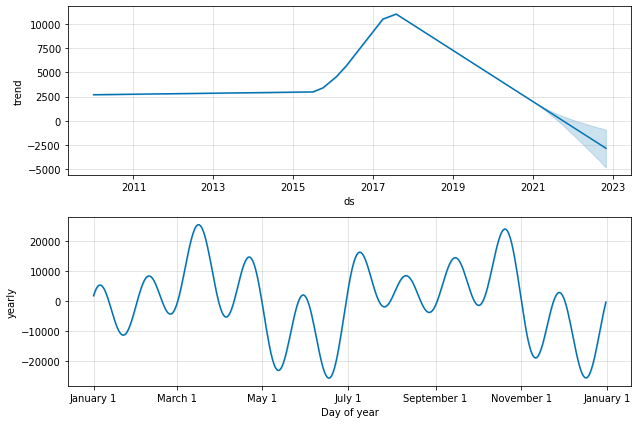

In [46]:
#seasionly components
fig_2 = model.plot_components(forecast)

In [47]:
#calculate root mean squre 
print('RMSE: %f' % np.sqrt(np.mean((forecast.loc[:140, 'yhat']-data['y'])**2)))

RMSE: 4065.003803


In [48]:
#join forecast & actual values dataframes
final_df = pd.merge(forecast, data, on=['ds'],how='left')

#convert mines predicted values in to absolute for increase the accuracy
final_df['yhat_abs'] = np.abs(final_df['yhat'])

In [49]:
final_df.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat,y,yhat_abs
0,2010-01-01,2700.832258,-1308.775468,9447.623687,2700.832258,2700.832258,1432.460018,1432.460018,1432.460018,1432.460018,1432.460018,1432.460018,0.0,0.0,0.0,4133.292275,4805.0,4133.292275
1,2010-02-01,2705.276247,-2786.367707,7243.305258,2705.276247,2705.276247,-443.076377,-443.076377,-443.076377,-443.076377,-443.076377,-443.076377,0.0,0.0,0.0,2262.199870,4731.0,2262.199870
2,2010-03-01,2709.290173,-3925.401704,6287.946854,2709.290173,2709.290173,-1501.600985,-1501.600985,-1501.600985,-1501.600985,-1501.600985,-1501.600985,0.0,0.0,0.0,1207.689188,2528.0,1207.689188
3,2010-04-01,2713.734163,-4175.067786,6132.337360,2713.734163,2713.734163,-1703.955472,-1703.955472,-1703.955472,-1703.955472,-1703.955472,-1703.955472,0.0,0.0,0.0,1009.778691,2004.0,1009.778691
4,2010-05-01,2718.034798,-2921.004876,7345.711899,2718.034798,2718.034798,-580.554408,-580.554408,-580.554408,-580.554408,-580.554408,-580.554408,0.0,0.0,0.0,2137.480390,1950.0,2137.480390


## **Final Dengue Cases Predictions Sri Lanka : 2021 To 2022**

In [50]:
#visualize actual & predicted values
fig = make_subplots(specs=[[{"secondary_y": False}]])

fig.add_trace(go.Scatter(
     x= final_df['ds'], y = final_df['y'],
     mode = 'lines',
     name='Actual',
     line=dict(width=1.5, color='limegreen')),secondary_y=False)

fig.add_trace(go.Scatter(
     x= final_df['ds'], y = final_df['yhat_abs'],
     mode = 'lines',
     name='Predicted',
     line=dict(width=1.5, color='gold')),secondary_y=False)

fig.update_layout(
     title = "Dengue Cases Forecast In Sri Lanka",
     title_font_size = 25, legend_font_size = 10,
     width = 1400, height = 620,
     template='plotly_dark')

fig.update_xaxes(
     title_text = 'Date',
     title_font=dict(size=15, family='Verdana', color='white'),
     tickfont=dict(family='Calibri', color='white', size=15))

fig.update_yaxes(title_text="Dengue Cases", secondary_y=False)

fig.show()

In [ ]:
#save nottbok as HTML file (remove all the comments inthis cell when running this error othersise will raise a error)
'''%%shell
jupyter nbconvert --to html '/content/Dengue_Cases_Forecasting_In_Sri_Lanka.ipynb''''